In [169]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.decomposition import PCA
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

from tensorflow.keras.models import Model, Sequential
from tensorflow.keras.layers import Input, Dense, BatchNormalization, Dropout, LeakyReLU
from tensorflow.keras.regularizers import L2
from tensorflow.keras.optimizers import Nadam
from tensorflow.keras.callbacks import ReduceLROnPlateau, EarlyStopping

from catboost import CatBoostRegressor

import joblib


## Загрузка датасета
Датасет представлен ввиде двух отдельных файлов, которые необходимо объеденить.

In [2]:
df_bp = pd.read_excel('./data/X_bp.xlsx')
df_nup = pd.read_excel('./data/X_nup.xlsx')

In [3]:
df_bp.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1023 entries, 0 to 1022
Data columns (total 11 columns):
 #   Column                                Non-Null Count  Dtype  
---  ------                                --------------  -----  
 0   Unnamed: 0                            1023 non-null   int64  
 1   Соотношение матрица-наполнитель       1023 non-null   float64
 2   Плотность, кг/м3                      1023 non-null   float64
 3   модуль упругости, ГПа                 1023 non-null   float64
 4   Количество отвердителя, м.%           1023 non-null   float64
 5   Содержание эпоксидных групп,%_2       1023 non-null   float64
 6   Температура вспышки, С_2              1023 non-null   float64
 7   Поверхностная плотность, г/м2         1023 non-null   float64
 8   Модуль упругости при растяжении, ГПа  1023 non-null   float64
 9   Прочность при растяжении, МПа         1023 non-null   float64
 10  Потребление смолы, г/м2               1023 non-null   float64
dtypes: float64(10), i

In [4]:
df_bp.drop('Unnamed: 0', axis=1, inplace=True)

В первой части датасета 1023 записи, типы данных определенные pandas соответвуют содержимому, колонок с отсутвующими значениями не наблюдается.

In [5]:
df_nup.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1040 entries, 0 to 1039
Data columns (total 4 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   Unnamed: 0          1040 non-null   int64  
 1   Угол нашивки, град  1040 non-null   int64  
 2   Шаг нашивки         1040 non-null   float64
 3   Плотность нашивки   1040 non-null   float64
dtypes: float64(2), int64(2)
memory usage: 32.6 KB


In [6]:
df_nup.drop('Unnamed: 0', axis=1, inplace = True)

Во второй части датасета 1040 записей, типы данных, определенные pandas соответвуют содержимому, колонок с отсутсвующими значениями не наблюдается.

В соответсвии с заданием, датасет необходимо объединить. Принимая во внимание, что во второй части записей больше, слева будем использовать датасет с меньшим количеством записей, объедением будет произведено с учетом индексов, "лишние" записи из второй части датасета будут отброшены.

In [7]:
data = df_bp.merge(df_nup,how='inner', left_index=True, right_index=True)

## EDA

In [8]:
data_info = pd.DataFrame({
    'Data Type':data.dtypes,
    'Unique Values': data.nunique()
    }).sort_values(by='Unique Values', ascending=True)
data_info

,Data Type,Unique Values
"Угол нашивки, град",int64,2
Плотность нашивки,float64,988
Шаг нашивки,float64,989
"Температура вспышки, С_2",float64,1003
"Потребление смолы, г/м2",float64,1003
"Содержание эпоксидных групп,%_2",float64,1004
"Поверхностная плотность, г/м2",float64,1004
"Модуль упругости при растяжении, ГПа",float64,1004
"Прочность при растяжении, МПа",float64,1004
"Количество отвердителя, м.%",float64,1005


Признак "Шаг нашивки" определяется всего 2-мя уникальными значениями.

In [9]:
data['Угол нашивки, град'].unique()

array([ 0, 90])

In [10]:
data['Угол нашивки, град'] = data['Угол нашивки, град'].replace({0:0.0, 90:1.0}).astype(float)

Для удобства дальнейшей работы с датасетом наименования колонок переведены на английский язык в соответсвии со словарем ниже.

In [11]:
FEATURES_NAMES = {
    'Соотношение матрица-наполнитель':'matrix-filler ratio',
    'Плотность, кг/м3':'density',
    'модуль упругости, ГПа':'elasticity modulus', 
    'Количество отвердителя, м.%':'hardener amount',
    'Содержание эпоксидных групп,%_2':'epoxy groups amount',
    'Температура вспышки, С_2':'flash point',
    'Поверхностная плотность, г/м2':'surface density',
    'Модуль упругости при растяжении, ГПа':'tensile modulus of elasticity',
    'Прочность при растяжении, МПа':'tensile strength',
    'Потребление смолы, г/м2':'resin consumption',
    'Угол нашивки, град':'patch angle', 
    'Шаг нашивки':'patch pitch',
    'Плотность нашивки':'patch density'  
                 } 

In [12]:
data.rename(columns=FEATURES_NAMES, inplace=True)

In [13]:
data.sample(10)

,matrix-filler ratio,density,elasticity modulus,hardener amount,epoxy groups amount,flash point,surface density,tensile modulus of elasticity,tensile strength,resin consumption,patch angle,patch pitch,patch density
980,2.576997,2012.504141,303.957981,105.604954,21.930317,292.175065,545.141835,76.663827,2462.976345,214.832139,1.0,7.590350,56.204164
125,2.927905,2012.549977,627.091103,97.740358,23.961702,280.527319,237.361035,74.066129,2170.832472,223.855681,0.0,4.295857,40.237716
325,2.177306,2104.054689,925.331575,92.618011,15.695894,298.930150,1067.898470,69.409454,2825.427474,218.946348,0.0,7.064692,70.092728
260,4.642236,1896.194305,581.094072,155.314446,24.628883,309.775503,520.511064,70.266007,3660.450210,183.274296,0.0,2.978589,59.874328
714,2.475633,2028.898103,862.687353,81.423196,21.057131,283.669264,172.547677,72.859651,2906.528829,172.608358,1.0,6.709407,52.366516
1001,3.955086,1964.723136,795.841068,104.017327,21.201765,346.297203,478.510413,73.750719,2720.673852,158.800965,1.0,10.450893,71.574356
365,2.375977,1918.698103,623.438576,130.594071,21.536946,276.464483,161.961969,72.490783,2790.299491,257.147389,0.0,2.215652,60.921929
747,4.660319,1987.700316,629.189776,139.342427,19.151985,304.039184,829.254993,71.744963,2576.325922,197.398991,1.0,10.285612,61.662903
936,2.807028,2029.296906,993.859728,74.690667,27.292550,226.555876,547.516759,71.680994,2528.082238,220.732220,1.0,0.037639,59.156843
824,2.892482,1973.190295,1098.669358,131.391858,23.468608,342.852349,830.096574,72.403615,2246.422016,277.596447,1.0,9.030872,52.962311


Данные представлены в разных шкалах, в дальнейшем, после удаления выбросов, их необходимо стандартизировать.

In [14]:
data.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
matrix-filler ratio,1023.0,2.930366,0.913222,0.389403,2.317887,2.906878,3.552660,5.591742
density,1023.0,1975.734888,73.729231,1731.764635,1924.155467,1977.621657,2021.374375,2207.773481
elasticity modulus,1023.0,739.923233,330.231581,2.436909,500.047452,739.664328,961.812526,1911.536477
hardener amount,1023.0,110.570769,28.295911,17.740275,92.443497,110.564840,129.730366,198.953207
epoxy groups amount,1023.0,22.244390,2.406301,14.254985,20.608034,22.230744,23.961934,33.000000
flash point,1023.0,285.882151,40.943260,100.000000,259.066528,285.896812,313.002106,413.273418
surface density,1023.0,482.731833,281.314690,0.603740,266.816645,451.864365,693.225017,1399.542362
tensile modulus of elasticity,1023.0,73.328571,3.118983,64.054061,71.245018,73.268805,75.356612,82.682051
tensile strength,1023.0,2466.922843,485.628006,1036.856605,2135.850448,2459.524526,2767.193119,3848.436732
resin consumption,1023.0,218.423144,59.735931,33.803026,179.627520,219.198882,257.481724,414.590628


### Вспомоглательные функции
- draw_outliers_boxplot - принимает DataFrame и оторажает для каждой колонки диаграмму "ящик с усами"
- detect_outliers - вспомогательная функция для поиска выбросов методом IQR ("межквартильного интервала"), отображения статистики по обнаруженным выбросам и их удаления. Аргументы функции: 
    * df : pd.DataFrame - датасет, с которым предстоит работа
    * remove_outliers: bool = False - булиевая переменная, если получено значение True выбросы бдут удалены.
    * show_stats: bool = True - булиевая переменная, при значении True будет выведена статистика по столбцам указывающая на количество выбросов.
- plot_helper_actual_and_predicted - вспомогательная функция для визуального сравнения исходных значений с предсказанными.
    * original_y - список исходных значений
    * predicted_y  - список предсказанных значений
    * title = '' - заголовок графика



In [15]:
def draw_outliers_boxplot(df):
    _, axis = plt.subplots(nrows = 4, ncols = 3, figsize = (10,18))

    clmns_plot = list(df.columns)

    try:
        clmns_plot.remove('patch angle')
    except:
        pass

    for ax, clmn in zip(axis.flat, clmns_plot):
        sns.boxplot(x = data[clmn],ax=ax, color='#7AB2D3')

plt.show()



def detect_outliers(df : pd.DataFrame,remove_outliers: bool = False, show_stats: bool = True):
    df['Is_Outlier'] = False
    outliers_count = 0

    for clmn in df.columns:
        if clmn == 'Is_Outlier':
            continue
        Q1 = df[clmn].quantile(0.25)
        Q3 = df[clmn].quantile(0.75)

        IQR = Q3 - Q1

        lower_bound = max(df[clmn].min(), Q1 - (1.5 * IQR)) 
        upper_bound = min(df[clmn].max(), Q3 + (1.5 * IQR)) 

        df.loc[(df[clmn] < lower_bound)|(df[clmn] > upper_bound), 'Is_Outlier'] = True

        outliers_count =len( df.loc[(df[clmn] < lower_bound)|(df[clmn] > upper_bound)])
        
        outliers_ratio = round((outliers_count / len(df))*100,4)
        
        if show_stats == True:
            print(f'|{clmn:<30}|{outliers_count:>10}|{outliers_ratio:>10}%|')

    total_outliers = len(data.loc[data['Is_Outlier'] == True])
    if show_stats == True:
        print(f'Всего выбросов: {total_outliers} строк, {round(total_outliers/df.shape[0],2)*100} %')

    if remove_outliers == True:
        df = df.drop(df.loc[df['Is_Outlier'] == True].index, axis = 0)
        df.drop('Is_Outlier', axis=1, inplace = True)
        return df
    
def plot_helper_actual_and_predicted(original_y, predicted_y, title = ''):    
    plt.figure(figsize=(10,5))
    plt.title(title, size=12)
    plt.plot(original_y, color='blue', label = 'Тестовые значения')
    plt.plot(predicted_y, color='red', label = 'Прогнозные значения')
    plt.legend(loc='best')
    plt.show()
    
    

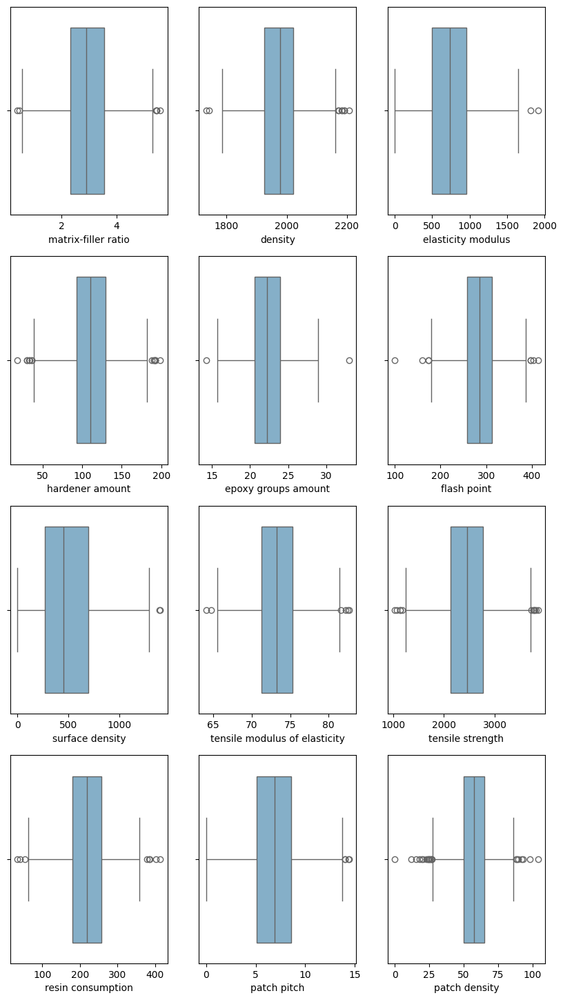

In [16]:
draw_outliers_boxplot(data)

In [17]:
detect_outliers(data)

|matrix-filler ratio           |         6|    0.5865%|
|density                       |         9|    0.8798%|
|elasticity modulus            |         2|    0.1955%|
|hardener amount               |        14|    1.3685%|
|epoxy groups amount           |         2|    0.1955%|
|flash point                   |         8|     0.782%|
|surface density               |         2|    0.1955%|
|tensile modulus of elasticity |         6|    0.5865%|
|tensile strength              |        11|    1.0753%|
|resin consumption             |         8|     0.782%|
|patch angle                   |         0|       0.0%|
|patch pitch                   |         4|     0.391%|
|patch density                 |        21|    2.0528%|
Всего выбросов: 87 строк, 9.0 %


Обнаружено достаточно большое количество выбросов - порядка 9%  от общего числа записей.

In [18]:
data = detect_outliers(data, remove_outliers=True, show_stats=False)

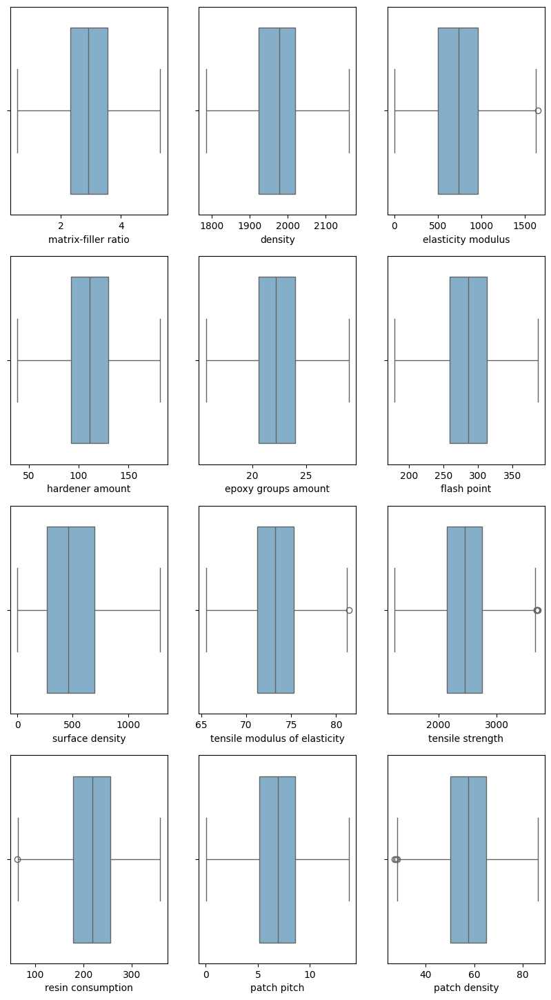

In [19]:
draw_outliers_boxplot(data)

После перой итерации при визуализации все еще наблюдаются выбросы.

In [20]:
data = detect_outliers(data, remove_outliers=True, show_stats=False)

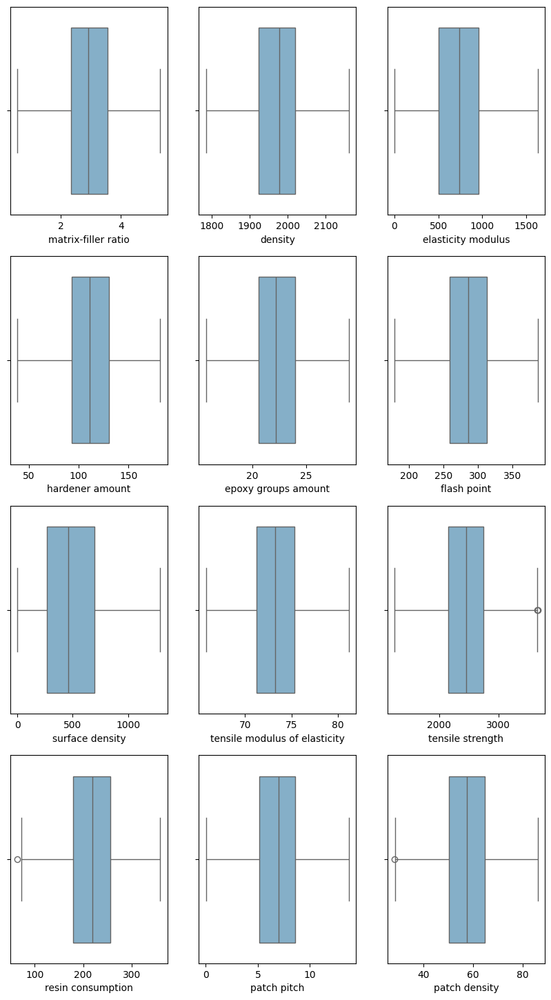

In [21]:
draw_outliers_boxplot(data)

In [22]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 926 entries, 1 to 1022
Data columns (total 13 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   matrix-filler ratio            926 non-null    float64
 1   density                        926 non-null    float64
 2   elasticity modulus             926 non-null    float64
 3   hardener amount                926 non-null    float64
 4   epoxy groups amount            926 non-null    float64
 5   flash point                    926 non-null    float64
 6   surface density                926 non-null    float64
 7   tensile modulus of elasticity  926 non-null    float64
 8   tensile strength               926 non-null    float64
 9   resin consumption              926 non-null    float64
 10  patch angle                    926 non-null    float64
 11  patch pitch                    926 non-null    float64
 12  patch density                  926 non-null    float64

In [23]:
scaler = StandardScaler()
data_std = pd.DataFrame(columns = data.columns, data = scaler.fit_transform(data))

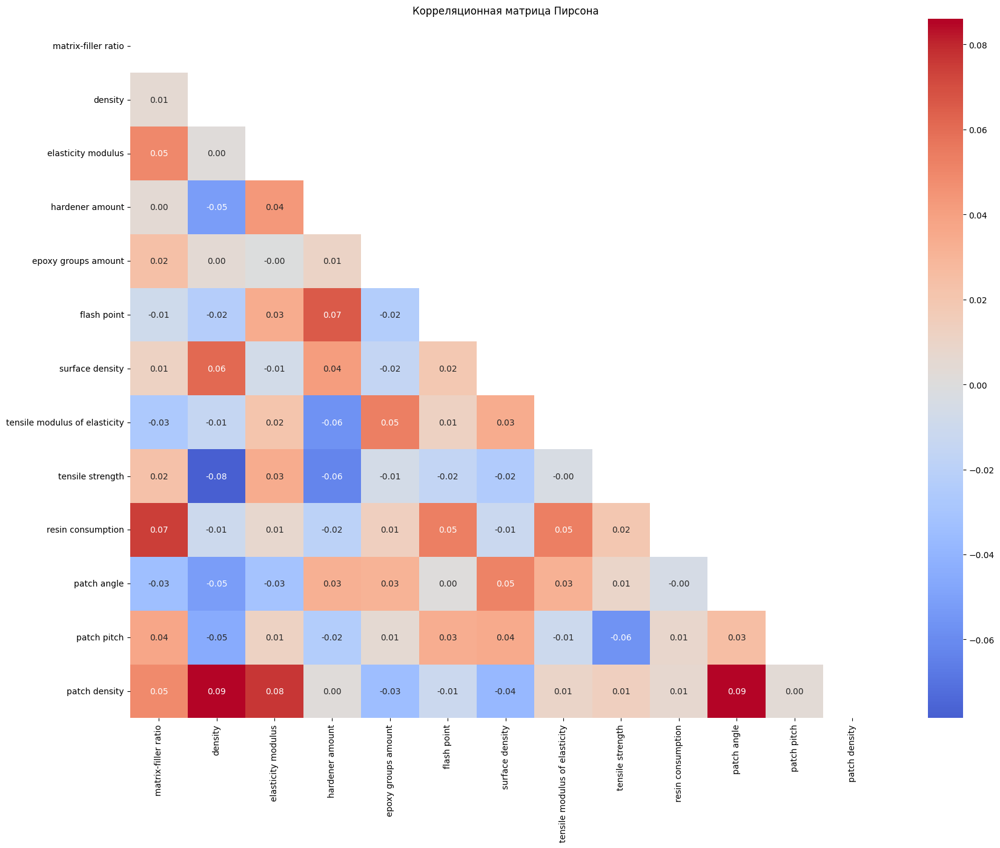

In [24]:
corr_map = data_std.corr(method = 'pearson')

plt.figure(figsize=(20,15))

mask = np.triu(np.ones_like(corr_map))

sns.heatmap(corr_map, annot=True, cmap='coolwarm', center=0, fmt=".2f", mask=mask)
plt.title('Корреляционная матрица Пирсона')
plt.show()

Значимых корреляций не наблюдается. 
Признаки мультиколинеарности отсутвуют, т.е. независимые признаки не связаны между собой, следовательно удалять/объеденять признаки нет необходимости.

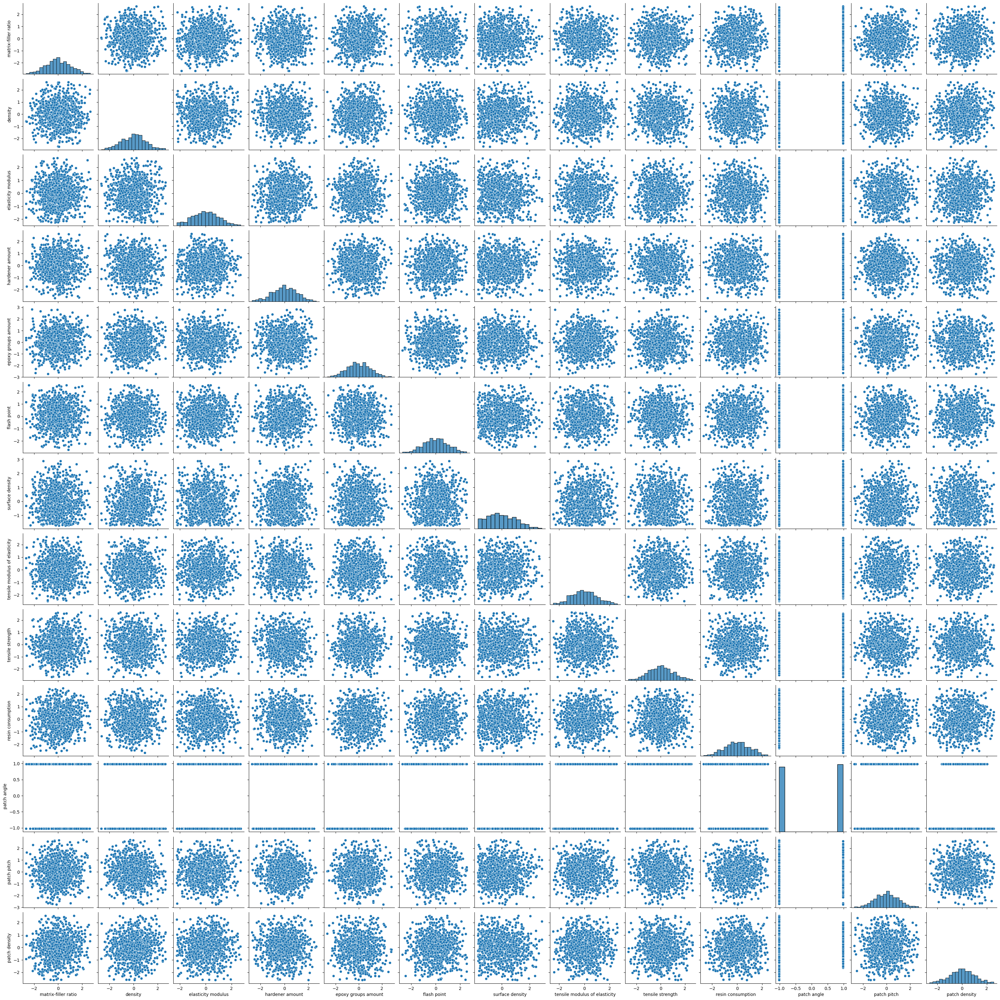

In [25]:
sns.pairplot(data_std)

In [26]:
features = data_std[['matrix-filler ratio', 'density', 'elasticity modulus',
       'hardener amount', 'epoxy groups amount', 'flash point',
       'surface density','resin consumption', 'patch angle', 'patch pitch', 'patch density']]
targets = data_std[['tensile modulus of elasticity', 'tensile strength']]

Отобразим попарные графики признаков-предикторов с целевыми признаками.

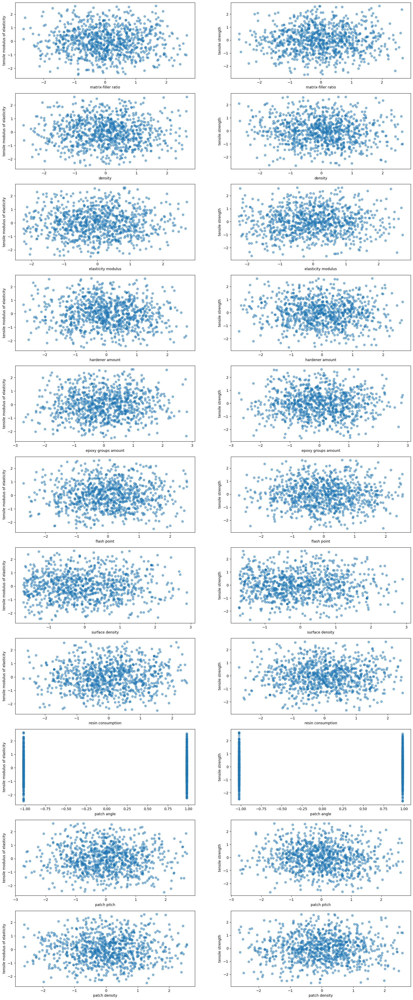

In [27]:
_, ax = plt.subplots(nrows= features.shape[1], ncols= targets.shape[1], figsize = (20,50))

for i,col in enumerate(features.columns):
    for j, col1 in enumerate(targets.columns):
        ax[i,j].scatter(x = features[col], y = targets[col1], alpha = 0.5)
        ax[i, j].set_xlabel(col)
        ax[i, j].set_ylabel(col1)

Линейных зависимостей не наблюдается. Аппроксимации простой линейной регрессией будет недостаточно.
Оценим знчимость признаков предикторов с помощью методов реализованных в RandomForestRegressor, их вклад в дисперсию используя метод локтя.

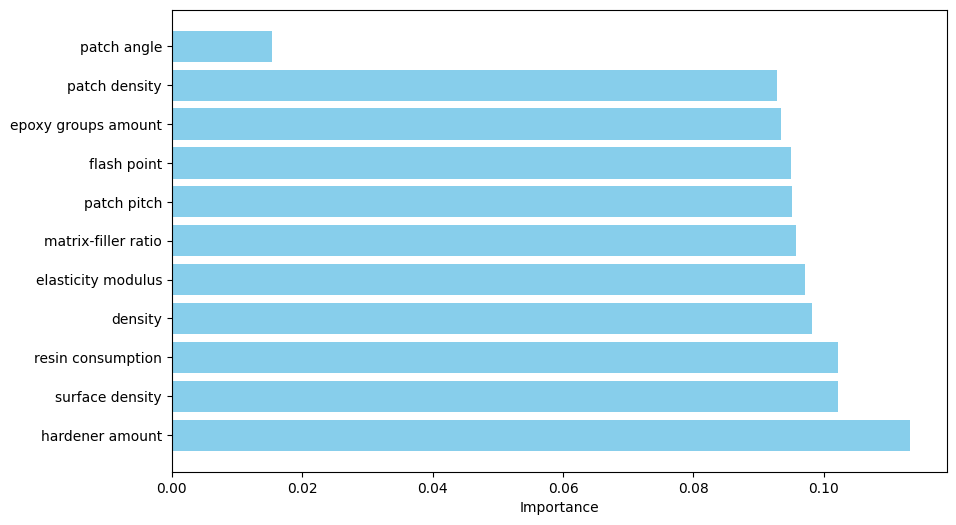

In [28]:
model_FI = RandomForestRegressor(n_estimators = 100, random_state = 42)
model_FI.fit(features, targets)

importances = model_FI.feature_importances_

feature_importance = pd.DataFrame(
    {
        'Feature': features.columns,
        'Importance': importances
    }
)

feature_importance = feature_importance.sort_values(by = 'Importance', ascending=False)

plt.figure(figsize=(10,6))
plt.barh(feature_importance['Feature'], feature_importance['Importance'],color='skyblue')
plt.xlabel('Importance')
plt.show()

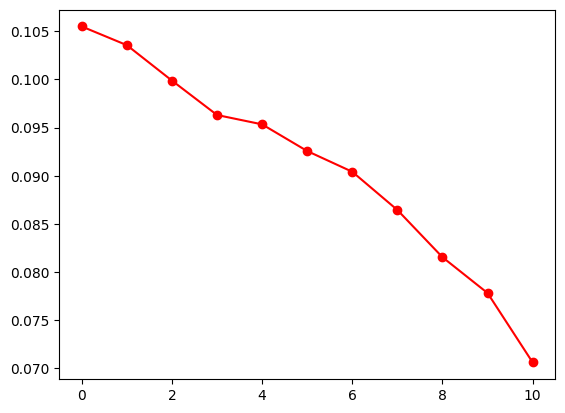

In [29]:
pca = PCA()
pca.fit(features, targets)

n_features = np.arange(pca.n_components_)

plt.plot(n_features, pca.explained_variance_ratio_, 'ro-')
plt.show()

Резкого изгиба не наблюдается, можно сделать вывод, что признаки вносят примерно равноценный вклад в дисперсию.

# Предсказание целевых признаков

## Модель - Модуль упругости при растяжении

In [199]:
features = data[['matrix-filler ratio', 'density', 'elasticity modulus',
       'hardener amount', 'epoxy groups amount', 'flash point',
       'surface density','resin consumption', 'patch angle', 'patch pitch', 'patch density']]
targets = data[['tensile modulus of elasticity', 'tensile strength']]

In [200]:
features_scaler = StandardScaler()
features = features_scaler.fit_transform(features)
targets_scaler = MinMaxScaler()
targets = targets_scaler.fit_transform(targets)

In [201]:
x_train, x_test, y_train, y_test = train_test_split(features, 
                                                    targets, 
                                                    train_size=0.8, 
                                                    random_state=42,
                                                    shuffle=True)

Для подбора наилучших параметров мы будем использовать поиск по сетке, это замедлит процесс "обучения", но даст больше шансов на положительный результат.

## Random Forest Regressor

In [202]:
model_rf_tme= RandomForestRegressor(criterion='squared_error',random_state=42)

params = {
    'n_estimators' : [50,100],
    'max_depth' : range(1, 7),
    'bootstrap' : [True, False]
}

GSCV_rf_tme = GridSearchCV(estimator=model_rf_tme, param_grid= params,cv = 2, n_jobs= 1, verbose= 3)
GSCV_rf_tme.fit(x_train, y_train[:,0])

RF_model_tme = GSCV_rf_tme.best_estimator_

RF_model_tme.score(x_test, y_test[:,0])

Fitting 2 folds for each of 24 candidates, totalling 48 fits
[CV 1/2] END bootstrap=True, max_depth=1, n_estimators=50;, score=-0.013 total time=   0.1s
[CV 2/2] END bootstrap=True, max_depth=1, n_estimators=50;, score=-0.011 total time=   0.3s
[CV 1/2] END bootstrap=True, max_depth=1, n_estimators=100;, score=-0.014 total time=   0.6s
[CV 2/2] END bootstrap=True, max_depth=1, n_estimators=100;, score=-0.011 total time=   0.5s
[CV 1/2] END bootstrap=True, max_depth=2, n_estimators=50;, score=-0.024 total time=   0.1s
[CV 2/2] END bootstrap=True, max_depth=2, n_estimators=50;, score=-0.022 total time=   0.1s
[CV 1/2] END bootstrap=True, max_depth=2, n_estimators=100;, score=-0.023 total time=   0.5s
[CV 2/2] END bootstrap=True, max_depth=2, n_estimators=100;, score=-0.023 total time=   0.3s
[CV 1/2] END bootstrap=True, max_depth=3, n_estimators=50;, score=-0.041 total time=   0.1s
[CV 2/2] END bootstrap=True, max_depth=3, n_estimators=50;, score=-0.030 total time=   0.2s
[CV 1/2] END bo

-0.012629951592243671

In [203]:
pred = RF_model_tme.predict(x_test)

rf_mse = mean_squared_error(y_true= y_test[:,0],y_pred=pred)
rf_mae = mean_absolute_error(y_true= y_test[:,0],y_pred=pred)
rf_r2 = r2_score(y_true= y_test[:,0],y_pred=pred)

rf_stats = {'Random Forest Regressor': [rf_mse, rf_mae, rf_r2]} 

Отрицательный коэффицент детерминации, говорит о том, что качество предсказаний уступает по точности, подходу если бы мы выдавали в качетве предсказания просто среднее значение по датасету.

## Gradient Boosting Regressor

In [204]:
model_gb_tme = GradientBoostingRegressor(learning_rate=0.0001, random_state = 42)
params = [
    {
        'learning_rate': [0.0001,0.00001],
        'n_estimators': [50, 100, 200],
        'loss': ['squared_error', 'absolute_error'],
        'criterion': ['friedman_mse', 'squared_error']    
    }
]
GSCV_gb_tme = GridSearchCV(estimator=model_gb_tme, param_grid=params, cv = 3, verbose=3)
GSCV_gb_tme.fit(x_train, y_train[:,0])

GB_model_tme = GSCV_gb_tme.best_estimator_

GB_model_tme.score(x_test, y_test[:,0])

Fitting 3 folds for each of 24 candidates, totalling 72 fits
[CV 1/3] END criterion=friedman_mse, learning_rate=0.0001, loss=squared_error, n_estimators=50;, score=-0.014 total time=   0.4s
[CV 2/3] END criterion=friedman_mse, learning_rate=0.0001, loss=squared_error, n_estimators=50;, score=-0.009 total time=   0.6s
[CV 3/3] END criterion=friedman_mse, learning_rate=0.0001, loss=squared_error, n_estimators=50;, score=-0.001 total time=   0.5s
[CV 1/3] END criterion=friedman_mse, learning_rate=0.0001, loss=squared_error, n_estimators=100;, score=-0.014 total time=   0.9s
[CV 2/3] END criterion=friedman_mse, learning_rate=0.0001, loss=squared_error, n_estimators=100;, score=-0.009 total time=   1.0s
[CV 3/3] END criterion=friedman_mse, learning_rate=0.0001, loss=squared_error, n_estimators=100;, score=-0.001 total time=   0.6s
[CV 1/3] END criterion=friedman_mse, learning_rate=0.0001, loss=squared_error, n_estimators=200;, score=-0.013 total time=   0.9s
[CV 2/3] END criterion=friedman_

-0.0008633800199444597

In [205]:
pred = GB_model_tme.predict(x_test)

gb_mse = mean_squared_error(y_true= y_test[:,0],y_pred=pred)
gb_mae = mean_absolute_error(y_true= y_test[:,0],y_pred=pred)
gb_r2 = r2_score(y_true= y_test[:,0],y_pred=pred)

gb_stats = {'Gradien Boosting Regressor': [gb_mse, gb_mae, gb_r2]} 

In [206]:
models_stats = {**rf_stats,**gb_stats}
models_stats.update({'Metrics': ['MSE', 'MAE', 'R2']})
models_stats = pd.DataFrame(models_stats)
models_stats = models_stats[['Metrics', 'Random Forest Regressor', 'Gradien Boosting Regressor']]


GradienBoostingRegressor показал результат схожий с RandomForestregressor.

## Модель нейронной сети для предсказания модуля упругости при растяжении и прочности при растяжении

In [156]:
x_train, x_val, y_train, y_val = train_test_split(x_train, y_train, test_size=0.1, random_state=42)

In [157]:
inputs = Input(shape = (x_train.shape[1],))

x_m1 = Dense(1024, kernel_initializer='he_normal', kernel_regularizer=L2(0.001))(inputs)
x_m1 = LeakyReLU(negative_slope = 0.2)(x_m1)
x_m1 = BatchNormalization()(x_m1)
x_m1 = Dropout(0.2)(x_m1)

x_m1 = Dense(1024, kernel_initializer='he_normal', kernel_regularizer=L2(0.001))(x_m1)
x_m1 = LeakyReLU(negative_slope = 0.01)(x_m1)
x_m1 = BatchNormalization()(x_m1)
x_m1 = Dropout(0.2)(x_m1)

x_m1 = Dense(1024, kernel_initializer='he_normal', kernel_regularizer=L2(0.001))(x_m1)
x_m1 = LeakyReLU(negative_slope = 0.01)(x_m1)
x_m1 = BatchNormalization()(x_m1)
x_m1 = Dropout(0.2)(x_m1)

x_m1 = Dense(1024, kernel_initializer='he_normal', kernel_regularizer=L2(0.001))(x_m1)
x_m1 = LeakyReLU(negative_slope = 0.01)(x_m1)
x_m1 = BatchNormalization()(x_m1)
x_m1 = Dropout(0.2)(x_m1)


x_m1 = Dense(1024, kernel_initializer='he_normal', kernel_regularizer=L2(0.001))(x_m1)
x_m1 = LeakyReLU(negative_slope = 0.01)(x_m1)
x_m1 = BatchNormalization()(x_m1)
x_m1 = Dropout(0.2)(x_m1)

x_m1 = Dense(1024, kernel_initializer='he_normal', kernel_regularizer=L2(0.001))(x_m1)
x_m1 = LeakyReLU(negative_slope = 0.01)(x_m1)
x_m1 = BatchNormalization()(x_m1)
x_m1 = Dropout(0.2)(x_m1)

x_m1 = Dense(1024, kernel_initializer='he_normal', kernel_regularizer=L2(0.001))(x_m1)
x_m1 = LeakyReLU(negative_slope = 0.01)(x_m1)
x_m1 = BatchNormalization()(x_m1)
x_m1 = Dropout(0.2)(x_m1)


output = Dense(2, activation ='linear')(x_m1)


model = Model(inputs, output)
optimizer = Nadam(learning_rate=0.01,weight_decay=1e-5, epsilon=0.00005, gradient_accumulation_steps=10, clipnorm=0.001)
model.compile(optimizer=optimizer, loss='MSE', metrics = ['mae'])

- Dense (плотные) слои:
    * kernel_initilaizer = he_normal : инициализирует веса нейронной сети значениями, взятыми из нормального распределения со средним значением 0 и стандартным отклонением sqrt(2/n), где n — количество нейронов в предыдущем слое
    * kernel_regularizer=L2 : регуляризатор L2 "штрафует" ядро слоя за регуляризацию весов, применяется для борьбы с переобучениемб к функции потерь добавляется штраф, пропорциональный квадрату величины весов модели. Это заставляет модель не только минимизировать ошибку на обучающих данных, но и сохранять веса как можно меньшими.
- Функция активации - LeakyReLu пропускает любое положительное значение без изменений и нивелирует любые отрицательные значения почти до нуля.
- Batch Normalization - для ускорения обучения выходной сигнал каждого слоя нормализуется. Суть метода заключается в том, что некоторым слоям нейронной сети на вход подаются данные, предварительно обработанные и имеющие нулевое математическое ожидание и единичную дисперсию. Нормализация делает сеть менее чувствительной к масштабу входных данных и улучшает общую стабильность процесса обучения. 
- Dropout -  случайным образом отключает некоторую долю нейронов слоя на каждом этапе обучения, обнуляя значения нейронов

В качетве оптимизатора использвался  Nadam (Nesterov-accelerated Adaptive Moment Estimation)


- Ранняя остановка используется, чтобы избежать переобучение. Если фунция потерь при валидации выходит на "плато" обучение останавливается, возвращаются веса из "наилучшей" эпохи обучения.
- Снижение LR используется для понижения скорости обучения, если функция потерь выходит на плото, используется для того, чтобы избежать "проваливания" в локальный минимум или зацикивания на "склонах".

In [158]:
early_stopping = EarlyStopping(monitor='val_loss', patience=20, restore_best_weights=True)
lr_adjustment = ReduceLROnPlateau(monitor='val_loss', factor=0.9, patience= 5, verbose = 1)

history = model.fit(x_train, y_train, epochs = 1500, 
                    batch_size=32, callbacks = [early_stopping, lr_adjustment], 
                    verbose =1, validation_data = (x_val, y_val))

Epoch 1/1500
21/21 ━━━━━━━━━━━━━━━━━━━━ 21s 152ms/step - loss: 17.2159 - mae: 1.3562 - val_loss: 15.2279 - val_mae: 0.7693 - learning_rate: 0.0100
Epoch 2/1500
21/21 ━━━━━━━━━━━━━━━━━━━━ 2s 118ms/step - loss: 16.2067 - mae: 1.0799 - val_loss: 14.6081 - val_mae: 0.4032 - learning_rate: 0.0100
Epoch 3/1500
21/21 ━━━━━━━━━━━━━━━━━━━━ 2s 114ms/step - loss: 16.0926 - mae: 1.0672 - val_loss: 14.4928 - val_mae: 0.3172 - learning_rate: 0.0100
Epoch 4/1500
21/21 ━━━━━━━━━━━━━━━━━━━━ 3s 124ms/step - loss: 15.7335 - mae: 0.9330 - val_loss: 14.4958 - val_mae: 0.3198 - learning_rate: 0.0100
Epoch 5/1500
21/21 ━━━━━━━━━━━━━━━━━━━━ 2s 118ms/step - loss: 15.5095 - mae: 0.8759 - val_loss: 14.4629 - val_mae: 0.2981 - learning_rate: 0.0100
Epoch 6/1500
21/21 ━━━━━━━━━━━━━━━━━━━━ 3s 125ms/step - loss: 15.3276 - mae: 0.7928 - val_loss: 14.4561 - val_mae: 0.2777 - learning_rate: 0.0100
Epoch 7/1500
21/21 ━━━━━━━━━━━━━━━━━━━━ 2s 112ms/step - loss: 15.1630 - mae: 0.7271 - val_loss: 14.4437 - val_mae: 0.2717 -

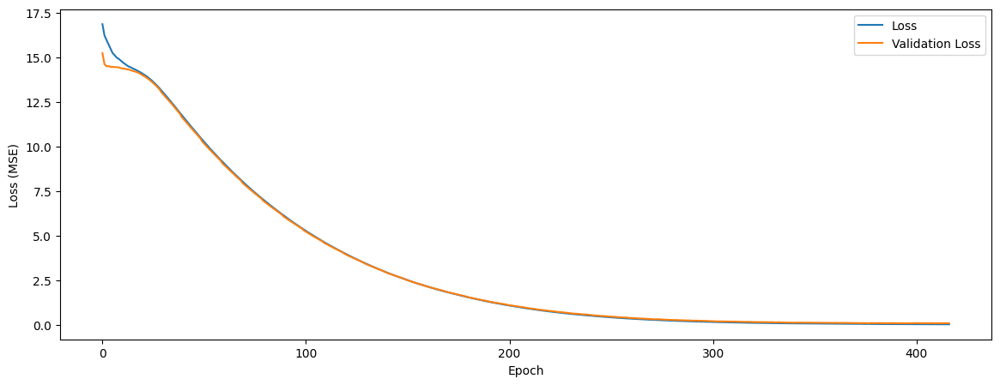

In [159]:
plt.figure(figsize=(14,5))


plt.subplot(1,1,1)
plt.plot(history.history['loss'], label = 'Loss')
plt.plot(history.history['val_loss'], label = 'Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss (MSE)')
plt.legend()


plt.show()

In [162]:
y_predicted = model.predict(x_test)
y_predicted_inversed = targets_scaler.inverse_transform(y_predicted)
y_test_inversed = targets_scaler.inverse_transform(y_test)

6/6 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step


## Визуализация предсказанных значений и их сравнение с реальными значениями

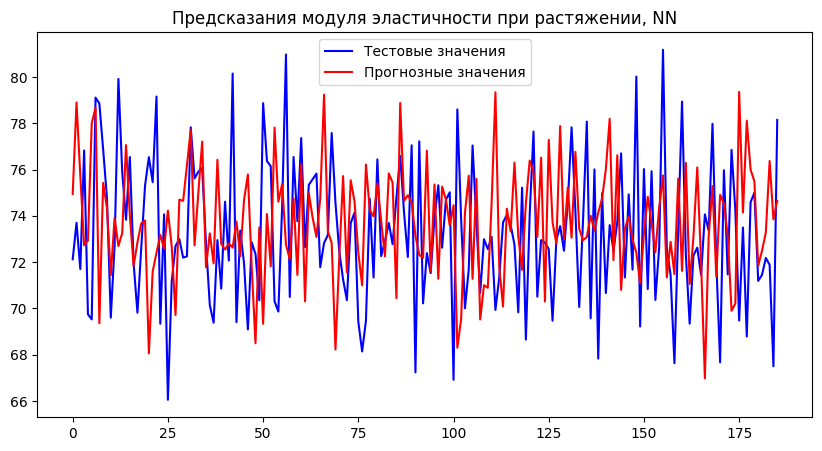

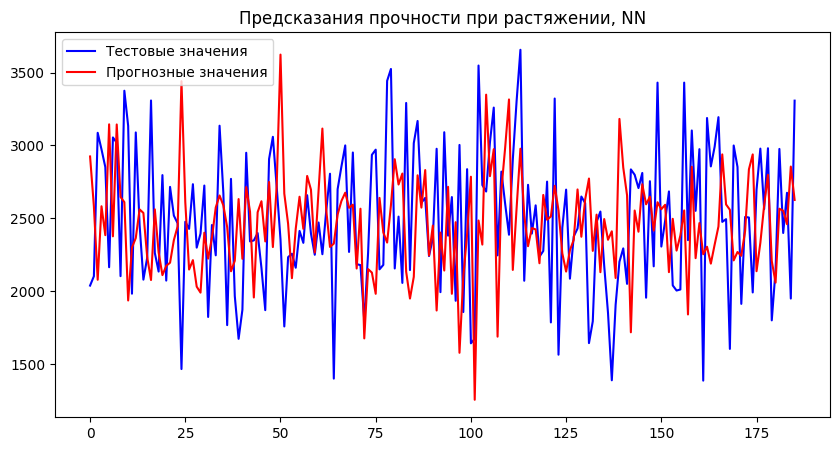

In [163]:
plot_helper_actual_and_predicted(original_y= y_test_inversed[:,0], predicted_y=y_predicted_inversed[:,0], title='Предсказания модуля эластичности при растяжении, NN')
plot_helper_actual_and_predicted(original_y= y_test_inversed[:,1], predicted_y=y_predicted_inversed[:,1], title='Предсказания прочности при растяжении, NN')


In [208]:
nn_mse = mean_squared_error(y_true= y_test,y_pred=y_predicted)
nn_mae = mean_absolute_error(y_true= y_test,y_pred=y_predicted)
nn_r2 = r2_score(y_true= y_test,y_pred=y_predicted)

models_stats['NN model'] = [nn_mse, nn_mae, nn_r2]
models_stats

,Metrics,Random Forest Regressor,Gradien Boosting Regressor,NN model
0,MSE,0.038405,0.037959,0.062140
1,MAE,0.155879,0.155418,0.199619
2,R2,-0.012630,-0.000863,-0.592179


Ни одна из моделей не продемонстрировала приемлимых результатов.

## Сохранение обученной модели нейронной сети, StandardScaler и  MinMaxScaler

In [ ]:
joblib.dump([features_scaler, targets_scaler], 'scalers.save')
model.save('nn_stregth_elasticity.keras')

### Рекомендация "соотношения матрица-наполинтель"

Для построения модели было принято решение использовать стэкинг. В качестве базовой модели разработана нейронная сеть, которая "предсказывает" соотношение матрица-наполнитель на основании конечных свойств композиционного материала. Выход нейронной сети передается в качетве входного сигнала CatBoostRegressor.

In [180]:
features = data[['tensile modulus of elasticity', 'tensile strength']]
target = data[['matrix-filler ratio']]
scaler_mf = StandardScaler()
features = scaler_mf.fit_transform(features)

x_train, x_test, y_train, y_test = train_test_split(features, target, test_size = 0.3)

In [181]:
model_mf_ratio = Sequential()
model_mf_ratio.add(Dense(512, input_shape = (x_train.shape[1],)))
model_mf_ratio.add(LeakyReLU(negative_slope = 0.01))
model_mf_ratio.add(BatchNormalization())
model_mf_ratio.add(Dense(128))
model_mf_ratio.add(LeakyReLU(negative_slope = 0.01))
model_mf_ratio.add(BatchNormalization())
model_mf_ratio.add(Dense(64))
model_mf_ratio.add(LeakyReLU(negative_slope = 0.01))
model_mf_ratio.add(BatchNormalization())
model_mf_ratio.add(Dense(32))
model_mf_ratio.add(LeakyReLU(negative_slope = 0.01))
model_mf_ratio.add(BatchNormalization())
model_mf_ratio.add(Dense(1, activation='linear'))

optimizer_mf = Nadam(learning_rate=0.01,weight_decay=1e-5, epsilon=0.00005, gradient_accumulation_steps=10, clipnorm=0.001)
model_mf_ratio.compile(optimizer = optimizer_mf, loss='MSE', metrics=['MAE'])

/Users/grebenyukandrey/Documents/Бауман/VKR_DRAFT/.venv/lib/python3.11/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


In [182]:
early_stopping_mf = EarlyStopping(monitor='loss', patience=20, restore_best_weights=True)
lr_adjustment_mf = ReduceLROnPlateau(monitor='loss', factor=0.9, patience= 5, verbose = 1)

history = model_mf_ratio.fit(x_train, y_train, epochs = 400, 
                    batch_size=32, callbacks = [early_stopping_mf, lr_adjustment_mf], 
                    verbose =1)

Epoch 1/400
21/21 ━━━━━━━━━━━━━━━━━━━━ 12s 5ms/step - MAE: 2.9394 - loss: 11.2704 - learning_rate: 0.0100
Epoch 2/400
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step - MAE: 2.8834 - loss: 9.5994 - learning_rate: 0.0100
Epoch 3/400
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step - MAE: 2.7861 - loss: 8.7132 - learning_rate: 0.0100
Epoch 4/400
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 5ms/step - MAE: 2.7074 - loss: 8.1896 - learning_rate: 0.0100
Epoch 5/400
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/step - MAE: 2.6297 - loss: 7.7436 - learning_rate: 0.0100
Epoch 6/400
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step - MAE: 2.4825 - loss: 7.0008 - learning_rate: 0.0100
Epoch 7/400
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - MAE: 2.4125 - loss: 6.6476 - learning_rate: 0.0100
Epoch 8/400
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/step - MAE: 2.2520 - loss: 5.8784 - learning_rate: 0.0100
Epoch 9/400
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - MAE: 2.1098 - loss: 5.2576 - learning_rate: 0.0100
Epoch 10/400
21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/step - MAE

In [186]:
cat_mf = CatBoostRegressor(iterations = 200000)
cat_mf.fit(model_mf_ratio.predict(x_train),y_train)



21/21 ━━━━━━━━━━━━━━━━━━━━ 0s 3ms/step
Learning rate set to 0.000515
0:	learn: 0.8878819	total: 1.48ms	remaining: 4m 56s
1:	learn: 0.8878008	total: 2.12ms	remaining: 3m 32s
2:	learn: 0.8877211	total: 2.68ms	remaining: 2m 58s
3:	learn: 0.8876434	total: 3.2ms	remaining: 2m 39s
4:	learn: 0.8875596	total: 4.25ms	remaining: 2m 50s
5:	learn: 0.8874801	total: 4.79ms	remaining: 2m 39s
6:	learn: 0.8873998	total: 5.33ms	remaining: 2m 32s
7:	learn: 0.8873215	total: 5.81ms	remaining: 2m 25s
8:	learn: 0.8872435	total: 6.28ms	remaining: 2m 19s
9:	learn: 0.8871717	total: 6.75ms	remaining: 2m 15s
10:	learn: 0.8870977	total: 7.24ms	remaining: 2m 11s
11:	learn: 0.8870230	total: 7.7ms	remaining: 2m 8s
12:	learn: 0.8869498	total: 8.05ms	remaining: 2m 3s
13:	learn: 0.8868777	total: 8.51ms	remaining: 2m 1s
14:	learn: 0.8868050	total: 8.98ms	remaining: 1m 59s
15:	learn: 0.8867315	total: 9.45ms	remaining: 1m 58s
16:	learn: 0.8866571	total: 9.93ms	remaining: 1m 56s
17:	learn: 0.8865809	total: 10.4ms	remaining:

In [187]:
final_preds = model_mf_ratio.predict(x_test)
final_preds = cat_mf.predict(final_preds)


9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 6ms/step 


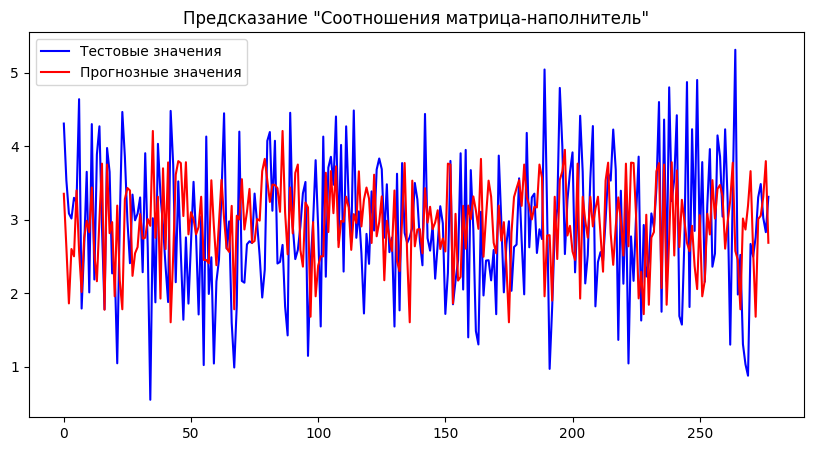

In [188]:
plot_helper_actual_and_predicted(y_test.values, final_preds, 'Предсказание "Соотношения матрица-наполнитель"')

По сравнительному графику видно, что модель в целом предсказывает динамику изменений целевой переменной, но очевидно, что точность далека от удовлетворительной для практического применения модели. 
Возможно при дальней более тонкой настроке  гиперпараметров нейронных сетей удалось бы добиться более надежного результата, также стоит отметить, что качество исходных данных и характер их распределения вероятно указывают на расширения датасета искусвенно сгенерированными данными. Можно заключить, что для улучшения предсказательной способности необходимо произвести обширную работу по сбору и очистке исходных данных.

In [171]:
joblib.dump(scaler_mf,'matrix_filler_features_scaler.save')
model_mf_ratio.save('model_mf.keras')
cat_mf.save_model('cat_mf.bin')